<a href="https://colab.research.google.com/github/keyapatel/Prompt-Engineering/blob/main/Image_Segmentaion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Segmentation

In [2]:
!pip install ultralytics torch

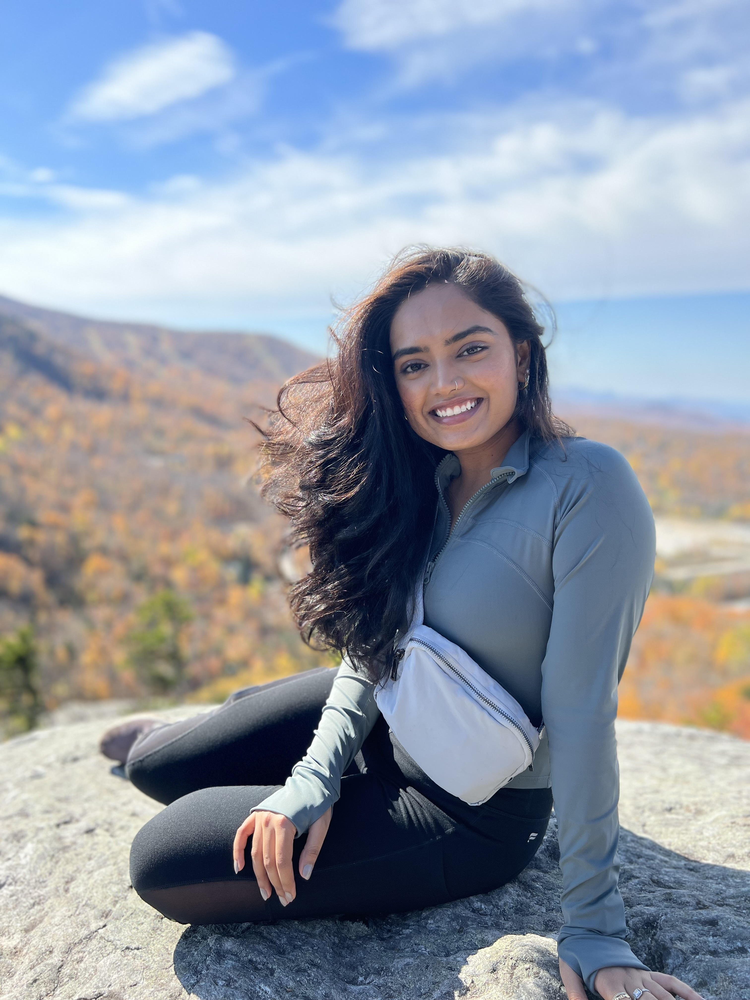

In [3]:
from PIL import Image
raw_image = Image.open("Keya.jpg")
raw_image

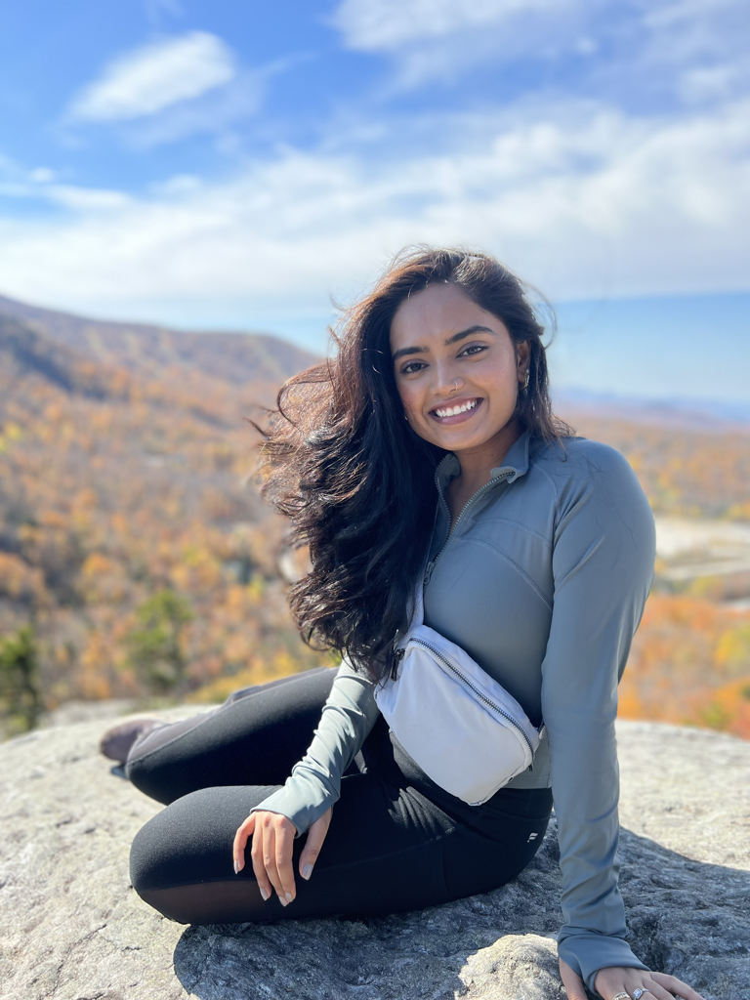

In [4]:
from utils import resize_image
resized_image = resize_image(raw_image, input_size=1024)
resized_image

In [5]:
import torch

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [7]:
from ultralytics import YOLO
model = YOLO('FastSAM.pt')

In [8]:
from utils import show_points_on_image

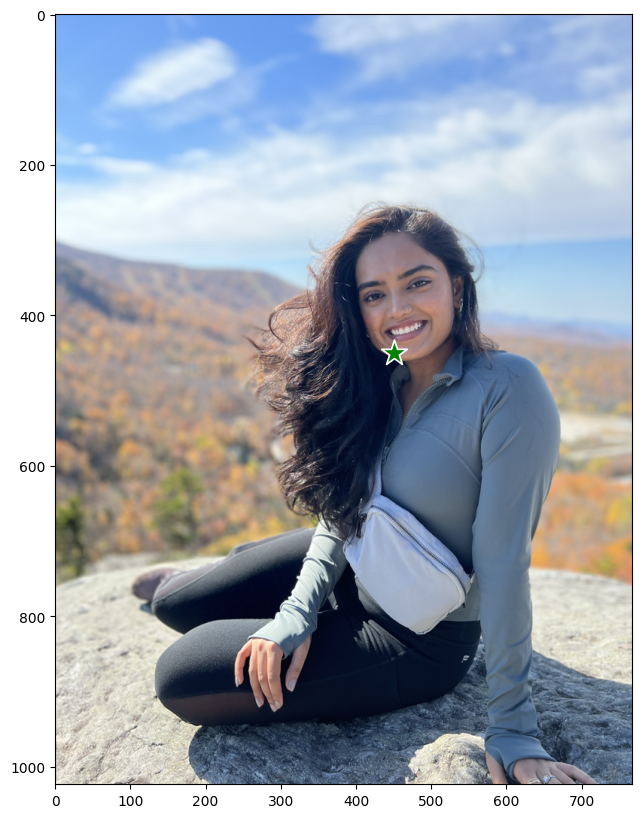

In [9]:
# Define the coordinates for the point in the image
# [x_axis, y_axis]
input_points = [ [450, 450 ] ]
input_labels = [1] # positive point
# Function written in the utils file
show_points_on_image(resized_image, input_points)

In [10]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 1024x768 31 objects, 13282.1ms
Speed: 41.0ms preprocess, 13282.1ms inference, 599.0ms postprocess per image at shape (1, 3, 1024, 768)


In [11]:
from utils import format_results, point_prompt

In [12]:
results = format_results(results[0], 0)
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)

In [13]:
from utils import show_masks_on_image

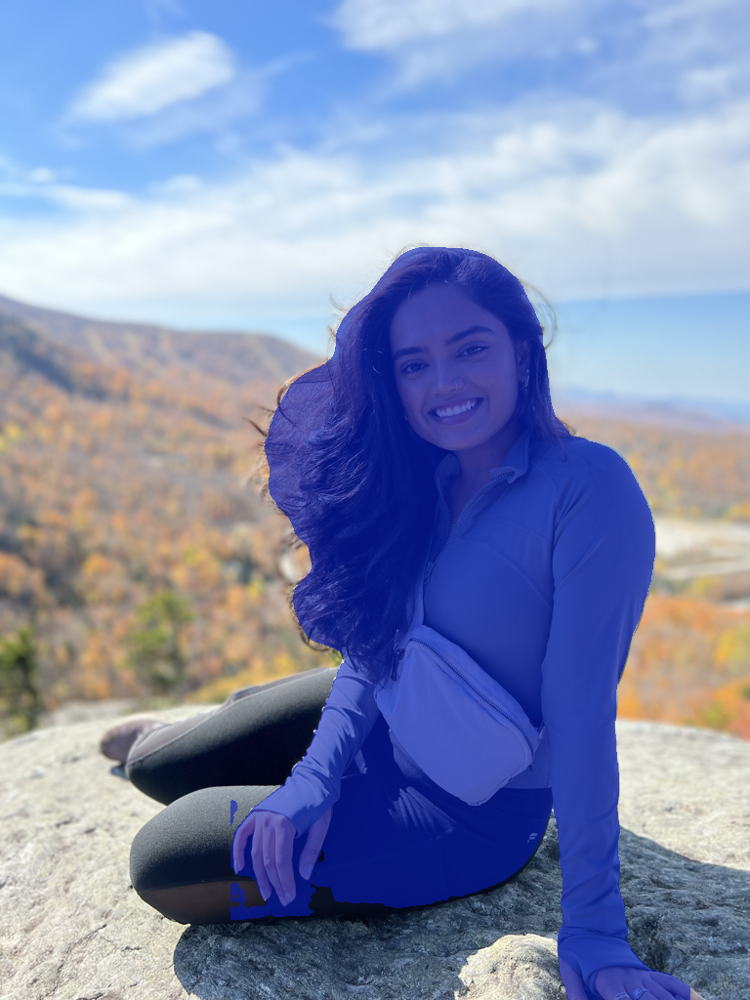

In [14]:
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

Define 'semantic masks' - three points to be masked.

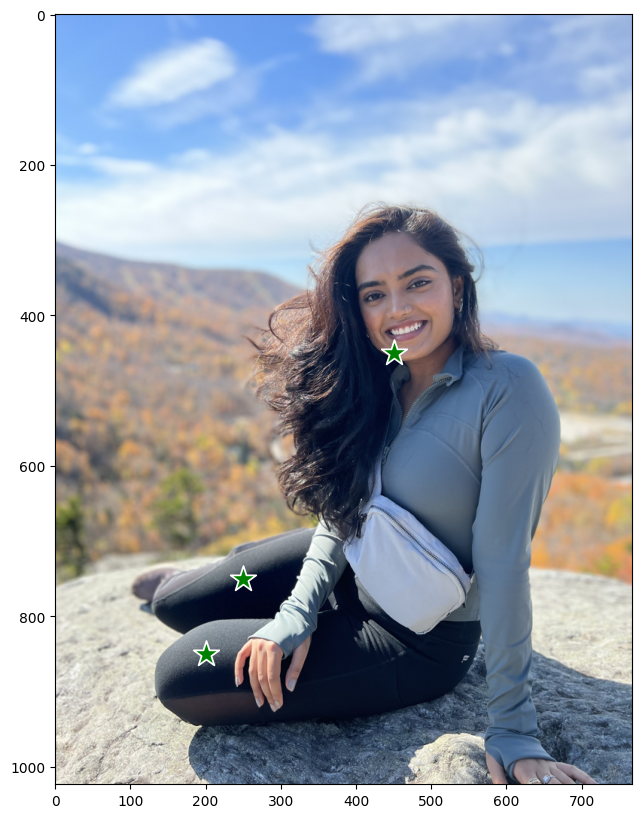

In [22]:
# Specify two points in the same image
# [x_axis, y_axis]
input_points = [ [450, 450], [250, 750], [200, 850] ]
# Specify both points as "positive prompt"
input_labels = [1, 1, 1] # both positive points
# Visualize the points defined before
show_points_on_image(resized_image, input_points)

In [23]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 1024x768 31 objects, 12823.8ms
Speed: 5.2ms preprocess, 12823.8ms inference, 482.7ms postprocess per image at shape (1, 3, 1024, 768)


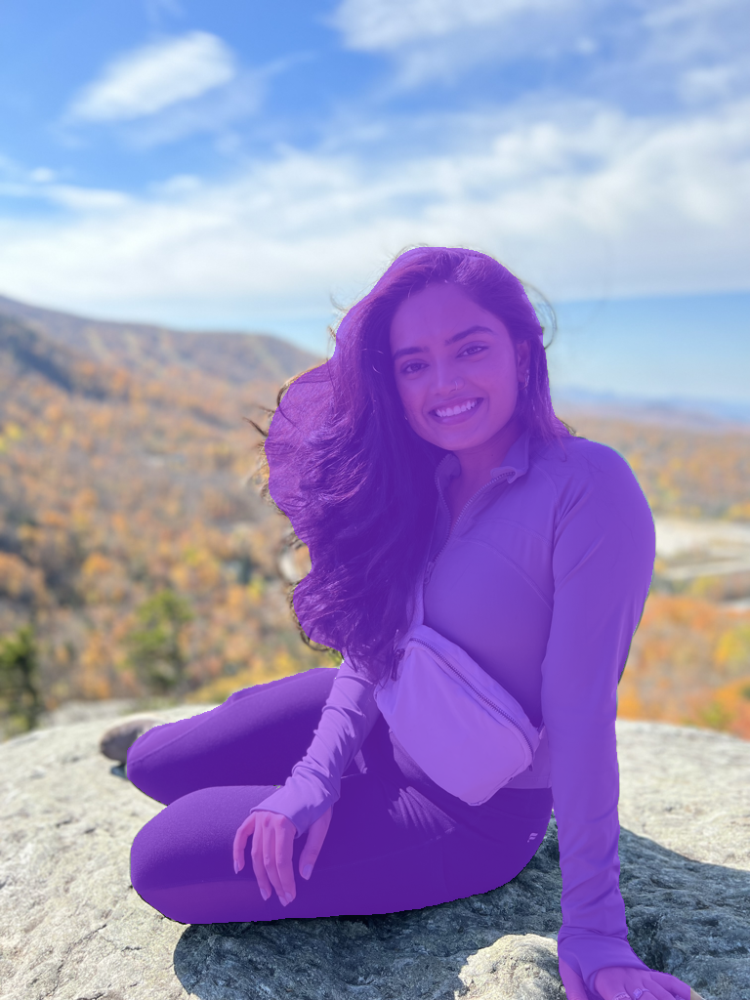

In [24]:
results = format_results(results[0], 0)
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

Identify subsections of the image by adding a negative prompt.

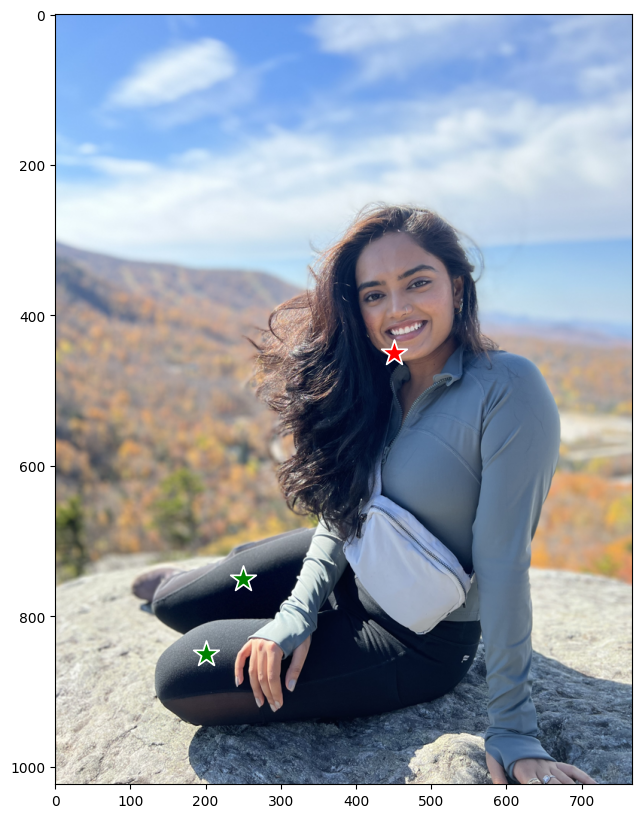

In [26]:
# Define the coordinates for the regions to be masked
# [x_axis, y_axis]
input_points = [ [450, 450], [250, 750], [200, 850]  ]
input_labels = [0, 1, 1] # negative prompt, positive prompt, positive prompt
# Visualize the points defined above
show_points_on_image(resized_image, input_points, input_labels)

In [27]:
# Run the model
results = model(resized_image, device=device, retina_masks=True)


0: 1024x768 31 objects, 12888.3ms
Speed: 5.7ms preprocess, 12888.3ms inference, 490.8ms postprocess per image at shape (1, 3, 1024, 768)


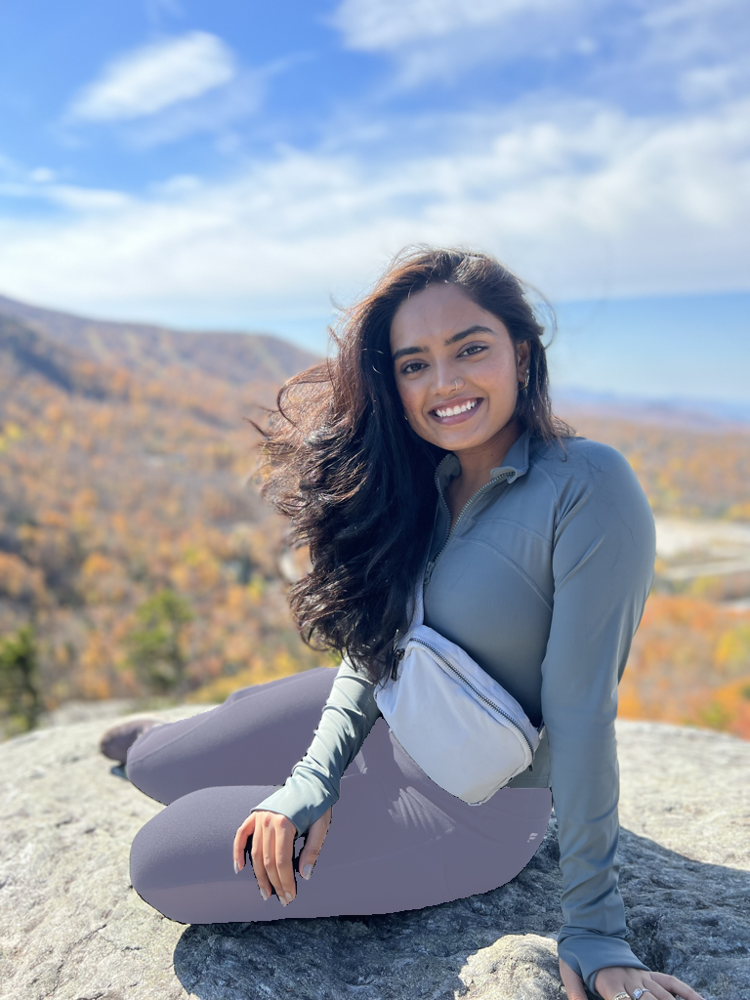

In [28]:
results = format_results(results[0], 0)
# Generate the masks
masks, _ = point_prompt(results, input_points, input_labels)
# Visualize the generated masks
show_masks_on_image(resized_image, [masks])

Prompting with bounding boxes

In [30]:
from utils import box_prompt
from utils import show_boxes_on_image

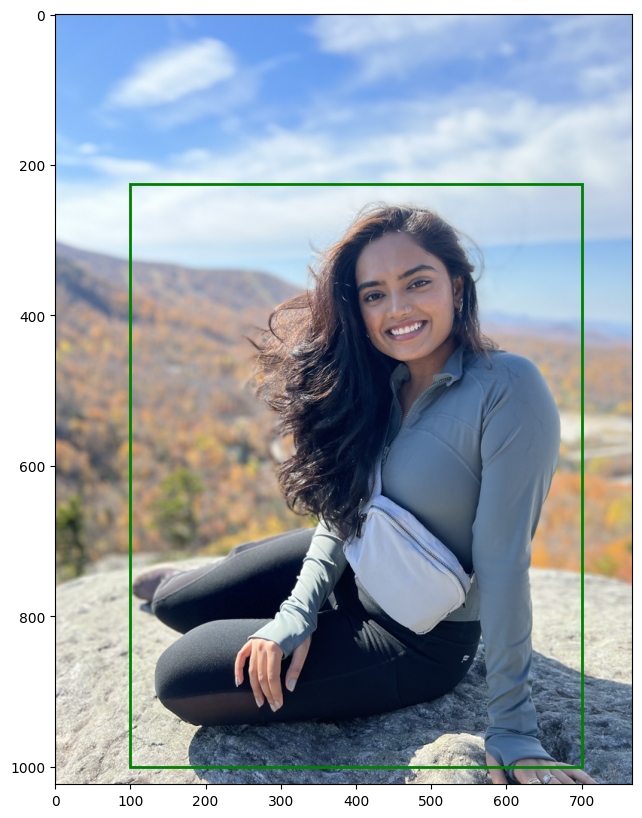

In [38]:
# Set the bounding box coordinates
# [xmin, ymin, xmax, ymax]
input_boxes = [100, 225, 700, 1000]
# Visualize the bounding box defined with the coordinates above
show_boxes_on_image(resized_image, [input_boxes])

Now, try to isolate the mask from the total output of the model.

In [33]:
from utils import box_prompt

In [39]:
results = model(resized_image, device=device, retina_masks=True)


0: 1024x768 31 objects, 13042.2ms
Speed: 9.8ms preprocess, 13042.2ms inference, 589.1ms postprocess per image at shape (1, 3, 1024, 768)


In [41]:
# Generate the masks
masks = results[0].masks.data
masks

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        ...,

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0., 

In [42]:
# Convert to True/False boolean mask
masks = masks > 0
masks

tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [

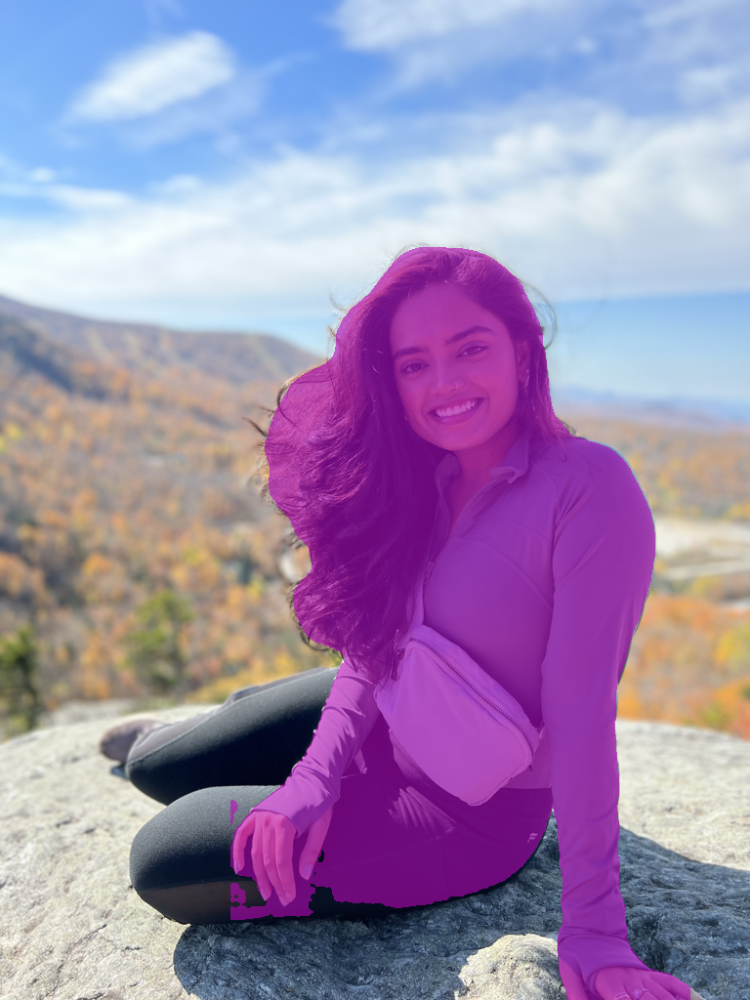

In [43]:
masks, _ = box_prompt(masks, input_boxes)
# Visualize the masks
show_masks_on_image(resized_image, [masks])

In [44]:
masks

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [45]:
# To visualize, import matplotlib
from matplotlib import pyplot as plt

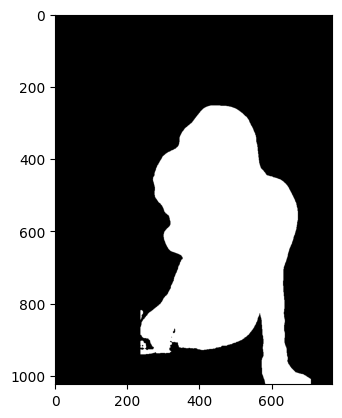

In [46]:
# Plot the binary mask as an image
plt.imshow(masks, cmap='gray')